<a href="https://colab.research.google.com/github/angie-c0der/Basic-Python-for-Machine-Learning/blob/main/code/Mobile_Price_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**SMART MOBILE PRICE PREDICTION**

##Step 1: Importing the libraries

In [ ]:
import pandas as pd
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, RocCurveDisplay, ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score

##Step 2: Reading the datasets

In [ ]:
test = pd.read_csv("/Users/DELL/Downloads/test.csv")
train = pd.read_csv("/Users/DELL/Downloads/train.csv")

In [ ]:
print('train_shape:',train.shape)

train_shape: (2000, 21)


###Step 2.1: Finding out the categorical and numerical features.

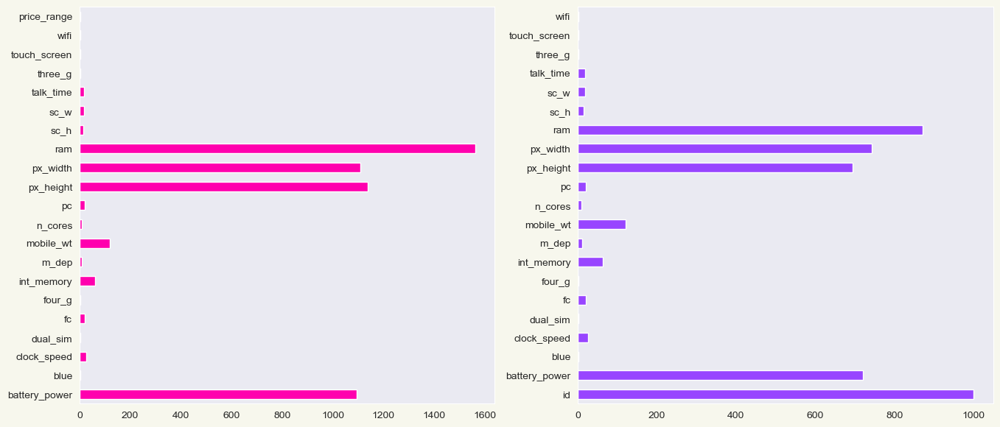

In [ ]:
sns.set_style('darkgrid')
color = 'royalblue'

fig, ax = plt.subplots(1, 2, figsize=(16,7),dpi=100,facecolor='#f7f7ed')
train.nunique().plot(kind='barh',color='#ff00ae',ax=ax[0],label='train')
ax[0].grid()
test.nunique().plot(kind='barh',color='#9845ff',ax=ax[1],label='test')
ax[1].grid()

*   According to the graphs above, the first thing we see is that the number of **ID** column values is equal to the total number of test dataset samples, so this column is not suitable for our model. So we should **remove it from out dataset**
*   Another point that can be understood from the above diagram is whether the columns are continuous or categorical. **If the number of unique data in each column is very high, it can be considered a continuous variable, and if it is the opposite, we consider that column to be categorical.**



In [ ]:
#Dropping the 'id' column from the test dataset.
test.drop('id',inplace=True,axis=1)

In [ ]:
#Displaying the column names.
train_without_target=train.drop('price_range',axis=1)
print("Train dataset columns: ")
for col in train.columns:
    print(col)
print(len(train.columns))
print("\nTrain dataset without target values columns: ")
for col in train_without_target.columns:
    print(col)
print(len(train_without_target.columns))

Train dataset columns: 
battery_power
blue
clock_speed
dual_sim
fc
four_g
int_memory
m_dep
mobile_wt
n_cores
pc
px_height
px_width
ram
sc_h
sc_w
talk_time
three_g
touch_screen
wifi
price_range
21

Train dataset without target values columns: 
battery_power
blue
clock_speed
dual_sim
fc
four_g
int_memory
m_dep
mobile_wt
n_cores
pc
px_height
px_width
ram
sc_h
sc_w
talk_time
three_g
touch_screen
wifi
20


##Step 2.2: Finding out if there are any null values in the train and test datasets.

In [ ]:
train.isnull().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
price_range      0
dtype: int64

In [ ]:
test.isnull().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
dtype: int64

There are no null values in both the datasets.

##Step 3: Train dataset

In [ ]:
# to see the columns in the whole dataset
max_col = len(train.columns)
pd.set_option("display.max_columns", max_col)
train.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1


###Step 3.1: Basic dataset information.

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

The dataset thus has no null values.

In [ ]:
train.describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,9.916500,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,6.064315,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,0.000000,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,5.000000,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,10.000000,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,15.000000,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,20.000000,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


The train dataset is defined as a pandas DataFrame with 2000 entries. It consists of a total of 21 columns, which correspond to the following features:

1.   battery_power: Battery power of the mobile phone (integer)
2.   blue: Presence of Bluetooth feature (mAh, integer)
3.   clock_speed: speed at which microprocessor executes instructions (float)
4.   dual_sim: Presence of dual SIM card support (integer)
5.   fc: Front camera pixel count (integer)
6.   four_g: Presence of 4G connectivity (integer)
7.   int_memory: Internal memory capacity (GB, integer)
8.   m_dep: Device thickness (cm, float)
9.   mobile_wt: Device weight (integer)
10.  n_cores: Number of processor cores (integer)
11.  pc: Rear camera pixel count (integer)
12.  px_height: Screen resolution height (integer)
13.  px_width: Screen resolution width (integer)
14.  ram: RAM capacity (MB, integer)
15.  sc_h: Screen height (cm, integer)
16.  sc_w: Screen width (cm, integer)
17.  talk_time: Talk time (longest time that a single battery charge, integer)
18.  three_g: Presence of 3G connectivity (integer)
19.  touch_screen: Presence of touch screen feature (integer)
20.  wifi: Presence of Wi-Fi connectivity (integer)
21.  price_range: Price range (integer)



There are no missing values (non-null count) in dataset.The majority of the features are of integer data type, with 19 columns, while 2 columns are of float data type.

###Step 3.1.2: To check whether there are any duplicate values

In [ ]:
train.index.duplicated().sum()

0

###Step 3.1.3: To see how many unique values are there for each feature

In [ ]:
train.nunique()

battery_power    1094
blue                2
clock_speed        26
dual_sim            2
fc                 20
four_g              2
int_memory         63
m_dep              10
mobile_wt         121
n_cores             8
pc                 21
px_height        1137
px_width         1109
ram              1562
sc_h               15
sc_w               19
talk_time          19
three_g             2
touch_screen        2
wifi                2
price_range         4
dtype: int64

In [ ]:
train.battery_power.unique()

array([ 842, 1021,  563, ..., 1139, 1467,  858], dtype=int64)

In [ ]:
train.blue.unique()

array([0, 1], dtype=int64)

In [ ]:
train.clock_speed.unique()

array([2.2, 0.5, 2.5, 1.2, 1.7, 0.6, 2.9, 2.8, 2.1, 1. , 0.9, 1.1, 2.6,
       1.4, 1.6, 2.7, 1.3, 2.3, 2. , 1.8, 3. , 1.5, 1.9, 2.4, 0.8, 0.7])

In [ ]:
train.dual_sim.unique()

array([0, 1], dtype=int64)

In [ ]:
train.fc.unique()

array([ 1,  0,  2, 13,  3,  4,  5,  7, 11, 12, 16,  6, 15,  8,  9, 10, 18,
       17, 14, 19], dtype=int64)

In [ ]:
train.four_g.unique()

array([0, 1], dtype=int64)

In [ ]:
train.int_memory.unique()

array([ 7, 53, 41, 10, 44, 22, 24,  9, 33, 17, 52, 46, 13, 23, 49, 19, 39,
       47, 38,  8, 57, 51, 21,  5, 60, 61,  6, 11, 50, 34, 20, 27, 42, 40,
       64, 14, 63, 43, 16, 48, 12, 55, 36, 30, 45, 29, 58, 25,  3, 54, 15,
       37, 31, 32,  4, 18,  2, 56, 26, 35, 59, 28, 62], dtype=int64)

In [ ]:
train.m_dep.unique()

array([0.6, 0.7, 0.9, 0.8, 0.1, 0.5, 1. , 0.3, 0.4, 0.2])

In [ ]:
train.mobile_wt.unique()

array([188, 136, 145, 131, 141, 164, 139, 187, 174,  93, 182, 177, 159,
       198, 185, 196, 121, 101,  81, 156, 199, 114, 111, 132, 143,  96,
       200,  88, 150, 107, 100, 157, 160, 119,  87, 152, 166, 110, 118,
       162, 127, 109, 102, 104, 148, 180, 128, 134, 144, 168, 155, 165,
        80, 138, 142,  90, 197, 172, 116,  85, 163, 178, 171, 103,  83,
       140, 194, 146, 192, 106, 135, 153,  89,  82, 130, 189, 181,  99,
       184, 195, 108, 133, 179, 147, 137, 190, 176,  84,  97, 124, 183,
       113,  92,  95, 151, 117,  94, 173, 105, 115,  91, 112, 123, 129,
       154, 191, 175,  86,  98, 125, 126, 158, 170, 161, 193, 169, 120,
       149, 186, 122, 167], dtype=int64)

In [ ]:
train.n_cores.unique()

array([2, 3, 5, 6, 1, 8, 4, 7], dtype=int64)

In [ ]:
train.pc.unique()

array([ 2,  6,  9, 14,  7, 10,  0, 15,  1, 18, 17, 11, 16,  4, 20, 13,  3,
       19,  8,  5, 12], dtype=int64)

In [ ]:
train.px_height.unique()

array([  20,  905, 1263, ...,  528,  915,  483], dtype=int64)

In [ ]:
train.px_width.unique()

array([ 756, 1988, 1716, ...,  743, 1890, 1632], dtype=int64)

In [ ]:
train.ram.unique()

array([2549, 2631, 2603, ..., 2032, 3057, 3919], dtype=int64)

In [ ]:
train.sc_h.unique()

array([ 9, 17, 11, 16,  8, 13, 19,  5, 14, 18,  7, 10, 12,  6, 15],
      dtype=int64)

In [ ]:

train.sc_w.unique()

array([ 7,  3,  2,  8,  1, 10,  9,  0, 15, 13,  5, 11,  4, 12,  6, 17, 14,
       16, 18], dtype=int64)

In [ ]:
train.talk_time.unique()

array([19,  7,  9, 11, 15, 10, 18,  5, 20, 12, 13,  2,  4,  3, 16,  6, 14,
       17,  8], dtype=int64)

In [ ]:
train.three_g.unique()

array([0, 1], dtype=int64)

In [ ]:
train.touch_screen.unique()

array([0, 1], dtype=int64)

In [ ]:
train.wifi.unique()

array([1, 0], dtype=int64)

In [ ]:
train.price_range.unique()

array([1, 2, 3, 0], dtype=int64)

In [ ]:
train.max(axis=0)
train.min(axis=0)

battery_power    501.0
blue               0.0
clock_speed        0.5
dual_sim           0.0
fc                 0.0
four_g             0.0
int_memory         2.0
m_dep              0.1
mobile_wt         80.0
n_cores            1.0
pc                 0.0
px_height          0.0
px_width         500.0
ram              256.0
sc_h               5.0
sc_w               0.0
talk_time          2.0
three_g            0.0
touch_screen       0.0
wifi               0.0
price_range        0.0
dtype: float64

###Step 3.1.4: Pearson correlation.

In [ ]:
train.corr()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
battery_power,1.000000,0.011252,0.011482,-0.041847,0.033334,0.015665,-0.004004,0.034085,0.001844,-0.029727,0.031441,0.014901,-0.008402,-0.000653,-0.029959,-0.021421,0.052510,0.011522,-0.010516,-0.008343,0.200723
blue,0.011252,1.000000,0.021419,0.035198,0.003593,0.013443,0.041177,0.004049,-0.008605,0.036161,-0.009952,-0.006872,-0.041533,0.026351,-0.002952,0.000613,0.013934,-0.030236,0.010061,-0.021863,0.020573
clock_speed,0.011482,0.021419,1.000000,-0.001315,-0.000434,-0.043073,0.006545,-0.014364,0.012350,-0.005724,-0.005245,-0.014523,-0.009476,0.003443,-0.029078,-0.007378,-0.011432,-0.046433,0.019756,-0.024471,-0.006606
dual_sim,-0.041847,0.035198,-0.001315,1.000000,-0.029123,0.003187,-0.015679,-0.022142,-0.008979,-0.024658,-0.017143,-0.020875,0.014291,0.041072,-0.011949,-0.016666,-0.039404,-0.014008,-0.017117,0.022740,0.017444
fc,0.033334,0.003593,-0.000434,-0.029123,1.000000,-0.016560,-0.029133,-0.001791,0.023618,-0.013356,0.644595,-0.009990,-0.005176,0.015099,-0.011014,-0.012373,-0.006829,0.001793,-0.014828,0.020085,0.021998
four_g,0.015665,0.013443,-0.043073,0.003187,-0.016560,1.000000,0.008690,-0.001823,-0.016537,-0.029706,-0.005598,-0.019236,0.007448,0.007313,0.027166,0.037005,-0.046628,0.584246,0.016758,-0.017620,0.014772
int_memory,-0.004004,0.041177,0.006545,-0.015679,-0.029133,0.008690,1.000000,0.006886,-0.034214,-0.028310,-0.033273,0.010441,-0.008335,0.032813,0.037771,0.011731,-0.002790,-0.009366,-0.026999,0.006993,0.044435
m_dep,0.034085,0.004049,-0.014364,-0.022142,-0.001791,-0.001823,0.006886,1.000000,0.021756,-0.003504,0.026282,0.025263,0.023566,-0.009434,-0.025348,-0.018388,0.017003,-0.012065,-0.002638,-0.028353,0.000853
mobile_wt,0.001844,-0.008605,0.012350,-0.008979,0.023618,-0.016537,-0.034214,0.021756,1.000000,-0.018989,0.018844,0.000939,0.000090,-0.002581,-0.033855,-0.020761,0.006209,0.001551,-0.014368,-0.000409,-0.030302
n_cores,-0.029727,0.036161,-0.005724,-0.024658,-0.013356,-0.029706,-0.028310,-0.003504,-0.018989,1.000000,-0.001193,-0.006872,0.024480,0.004868,-0.000315,0.025826,0.013148,-0.014733,0.023774,-0.009964,0.004399


In [ ]:
corr_matrix = train.corr().abs()
print(corr_matrix)

               battery_power      blue  clock_speed  dual_sim        fc  \
battery_power       1.000000  0.011252     0.011482  0.041847  0.033334   
blue                0.011252  1.000000     0.021419  0.035198  0.003593   
clock_speed         0.011482  0.021419     1.000000  0.001315  0.000434   
dual_sim            0.041847  0.035198     0.001315  1.000000  0.029123   
fc                  0.033334  0.003593     0.000434  0.029123  1.000000   
four_g              0.015665  0.013443     0.043073  0.003187  0.016560   
int_memory          0.004004  0.041177     0.006545  0.015679  0.029133   
m_dep               0.034085  0.004049     0.014364  0.022142  0.001791   
mobile_wt           0.001844  0.008605     0.012350  0.008979  0.023618   
n_cores             0.029727  0.036161     0.005724  0.024658  0.013356   
pc                  0.031441  0.009952     0.005245  0.017143  0.644595   
px_height           0.014901  0.006872     0.014523  0.020875  0.009990   
px_width            0.008

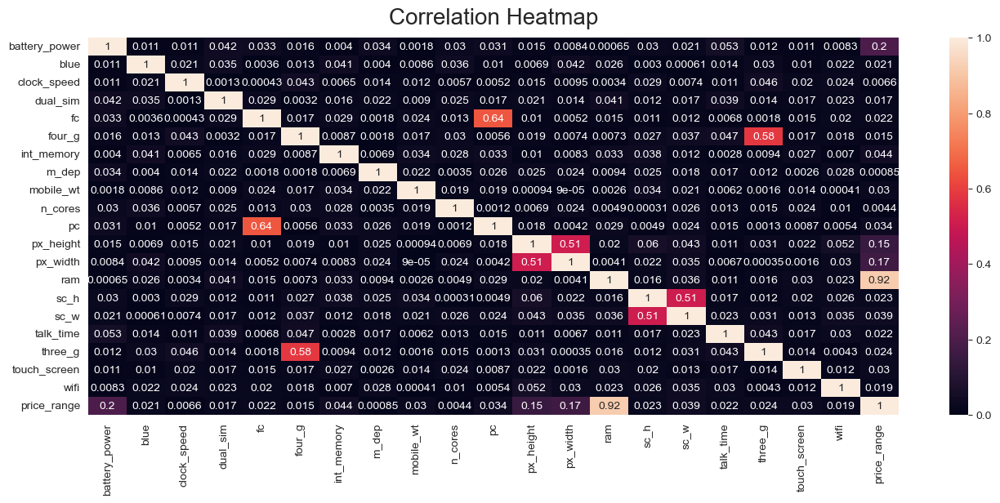

In [ ]:
plt.figure(figsize=(16, 6))
# Store heatmap object in a variable to easily access it when you want to include more features (such as title).
# Set the range of values to be displayed on the colormap from 0 to 1, and set the annotation to True to display the correlation values on the heatmap.
heatmap = sns.heatmap(corr_matrix, vmin=0, vmax=1, annot=True)
# Give a title to the heatmap. Pad defines the distance of the title from the top of the heatmap.
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':20}, pad=12);

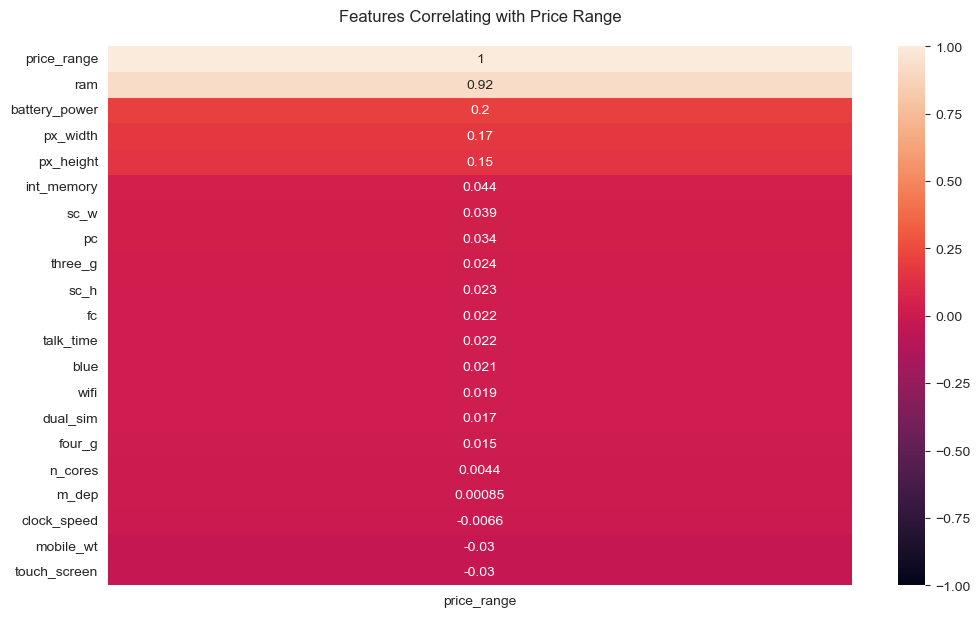

In [ ]:
plt.figure (figsize = (12, 7), dpi = 100)
heatmap = sns.heatmap (train.corr()[['price_range']].sort_values (by = 'price_range', ascending = False), vmin = -1, vmax = 1, annot = True)
heatmap.set_title ('Features Correlating with Price Range', fontdict = {'fontsize':12}, pad = 18);


*  There is a strong correlation between ram and price_range.
price_range has a low correlation value with the rest of the features, but this cannot be used as a criterion to remove these features since the pearson correlation only expresses the linear relationship between two variables.
*  We can see a moderate correlation between 4G and 3G, fc and pc, px_height and px_width, sc_h and sc_w.

##Step 4: Data Visualization of train dataset.

###Step 4.1 Checking if we have a balanced dataset.

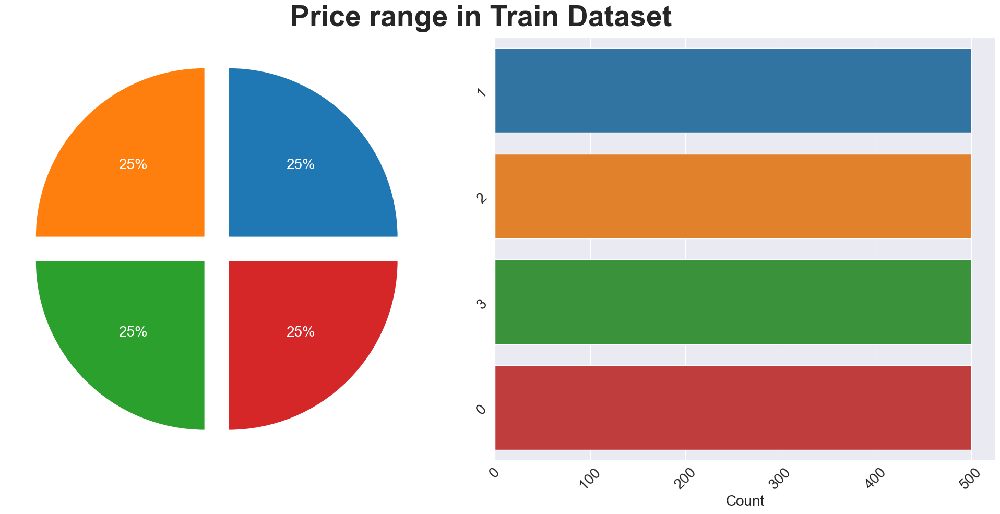

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (20, 10))
ax = ax.flatten()

ax[0].pie(
    train['price_range'].value_counts(),
    autopct = '%1.f%%',
    textprops = {'size' : 20, 'color' : 'white'},
    explode = [.1 for i in range(0, 4)],
    )

sns.countplot(data = train, y = 'price_range', ax = ax[1], order = train['price_range'].value_counts().index)
ax[1].yaxis.label.set_size(20)
plt.yticks(fontsize = 20,rotation=45)
ax[1].set_xlabel('Count', fontsize = 20)
ax[1].set_ylabel(None)
plt.xticks(fontsize = 20, rotation=45)

fig.suptitle('Price range in Train Dataset', fontsize = 40, fontweight = 'bold')
plt.tight_layout()

Yes, we indeed has a balanced dataset. So we can use *Accuracy* for evaluation purposes.

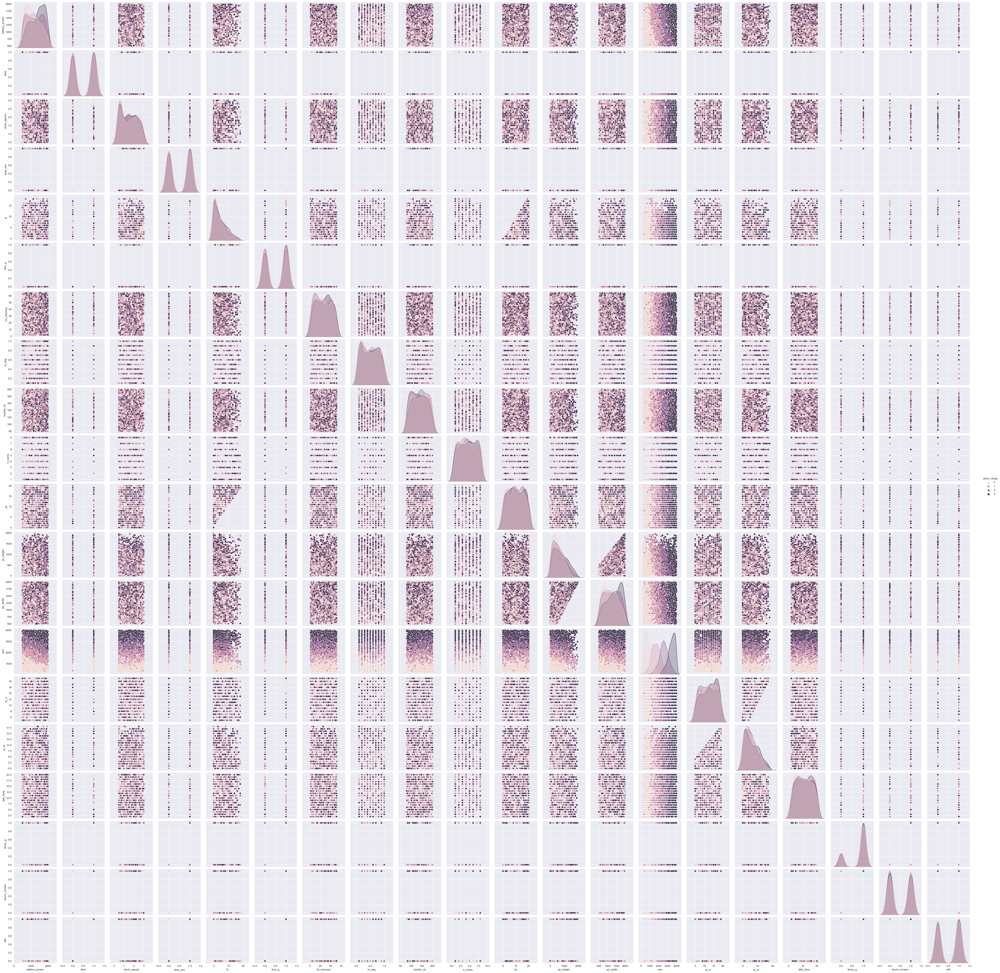

In [ ]:
sns.pairplot(train,hue='price_range')

###Step 4.2 Plotting the scatterplots side-by-side.

In [ ]:
# Defining a function to draw the scatter plots between the target and features:

def scatter_plots(train_name, x_ax_name, y_ax_name):
    scatter_name = f"{y_ax_name}-{x_ax_name}"
    fig_output_name = scatter_name
    plt.title(f"{x_ax_name} - {y_ax_name}\n")
    scatter_name = plt.scatter(train_name[x_ax_name], train_name[y_ax_name])
    scatter_name.axes.tick_params(gridOn=True, size=12, labelsize=10)
    plt.xlabel(f"\n{x_ax_name}", fontsize=20)
    plt.ylabel(f"{y_ax_name}\n", fontsize=20)
    plt.xticks(rotation=90)

In [ ]:
# defining a function to draw scatter plots side by side:

def scatter_subplots(train):
    i=0
    j = len(train.columns)-1
    while i < len(train.columns)-1:
        plt.figure(figsize=(20,8), dpi=80)
        for k in range(3):
            plt.subplot(1, 3, k+1)
            scatter_plots(train, train.columns[i], train.columns[j])
            plt.title(f"{train.columns[i]} - {train.columns[j]}", fontsize=20)
            i += 1
        plt.suptitle("Plotting Each Feature Against The Target", size = 30, fontweight = "bold")
        plt.tight_layout()
        plt.show()
        if j-i == 2:
            plt.subplot(1, 2, 1)
            scatter_plots(train, train.columns[i], train.columns[j])
            plt.title(f"{train.columns[i]} - {train.columns[j]}", fontsize=20)
            i += 1
            plt.subplot(1, 2, 2)
            scatter_plots(train, train.columns[i], train.columns[j])
            plt.title(f"{train.columns[i]} - {train.columns[j]}", fontsize=20)
            i += 1
            plt.suptitle("Plotting Each Feature Against The Target", size = 30, fontweight = "bold")
            plt.tight_layout()
            plt.subplots_adjust(wspace=2.5)
            plt.show()
        elif j-i == 1:
            scatter_plots(train, train.columns[i], train.columns[j])
            plt.title(f"{train.columns[i]} - {train.columns[j]}", fontsize=20)
            i += 1
            plt.suptitle("Plotting Each Feature Against The Target", size = 30, fontweight = "bold")
            plt.tight_layout()
            plt.subplots_adjust(wspace=2.5)
            plt.show()
        elif i == j:
            break

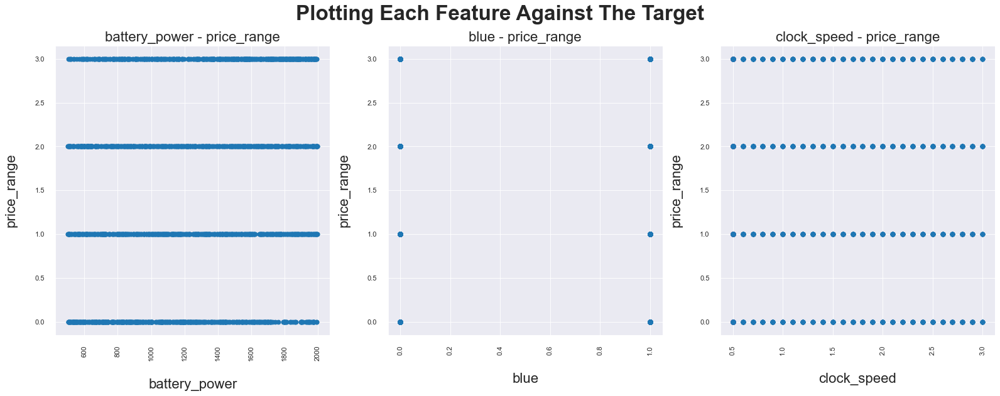

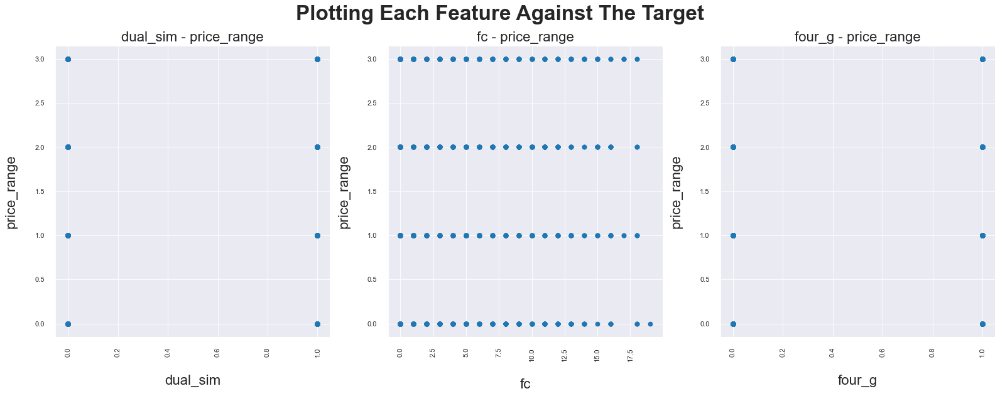

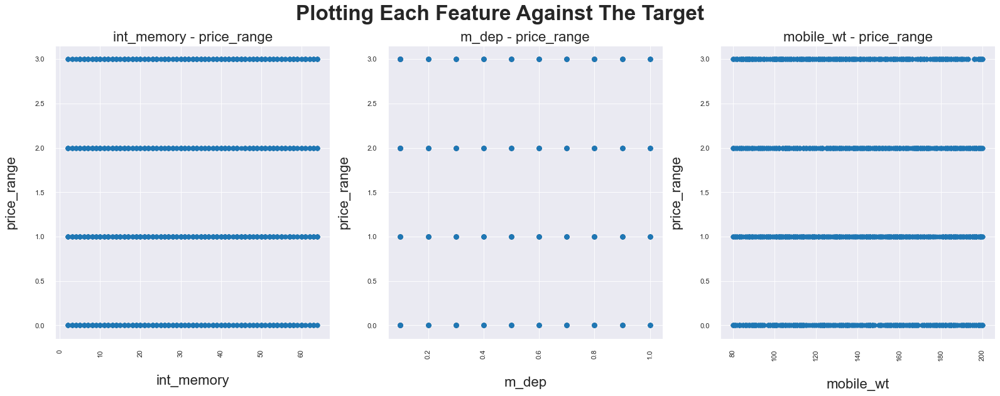

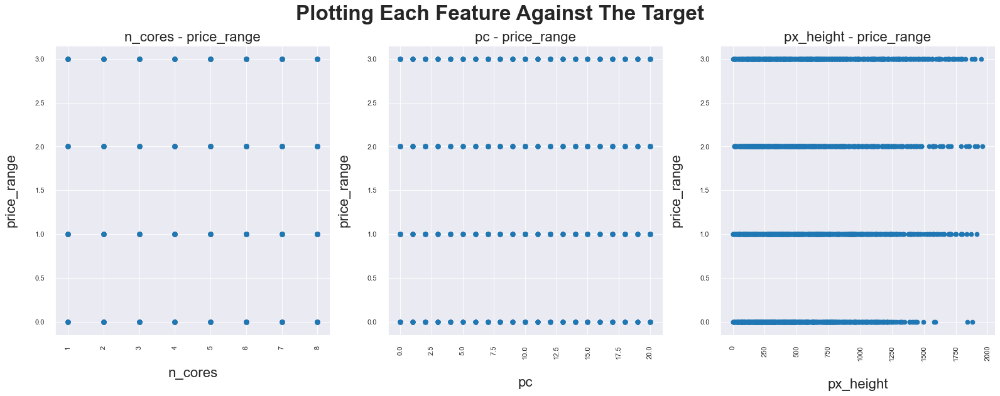

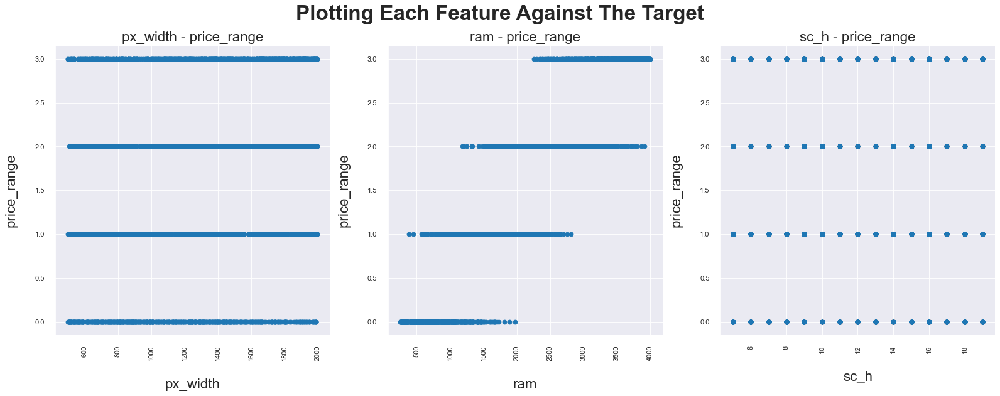

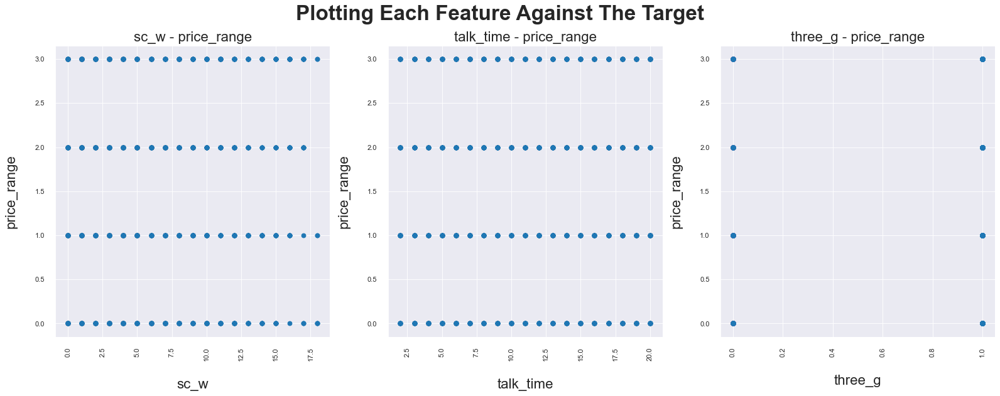

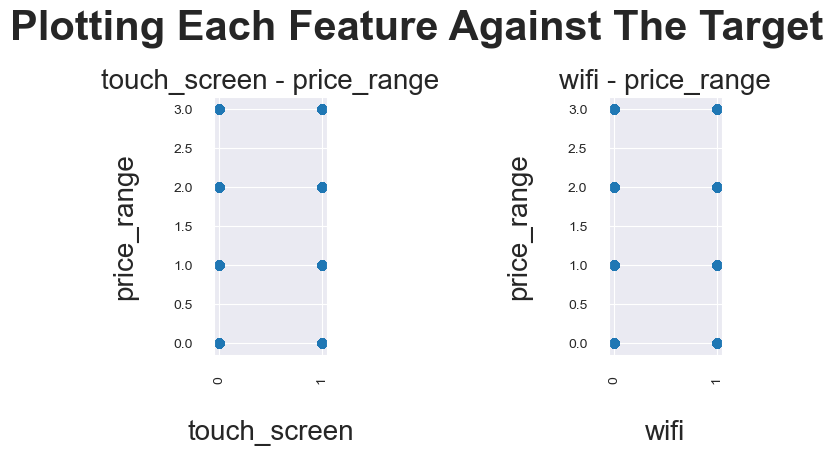

In [ ]:
# Plotting the scatterplots against 'price_range'.
scatter_subplots(train)

###Step 4.3: Obtain the 'Count plot'.

A count plot shows the counts of observations in each categorical bin using bars.It can be thought of as a histogram across a categorical, instead of quantitative, variable.

In [ ]:
#defining a function to count the redundancy of categories in each feature:

def count_plots(df_name, column_name):

    plt.figure(figsize=(20, 8), dpi=90)
    ax = sns.countplot(x=column_name, data=train)
    ax.bar_label(ax.containers[0], fontsize=13)
    plt.xticks(rotation=90, fontsize=12)
    plt.yticks(fontsize=15)
    plt.xlabel(f"\n{column_name}", fontsize=20)
    plt.ylabel("count",fontsize=20)
    plt.title(f"Count of {column_name}", fontsize=30)
    plt.grid()

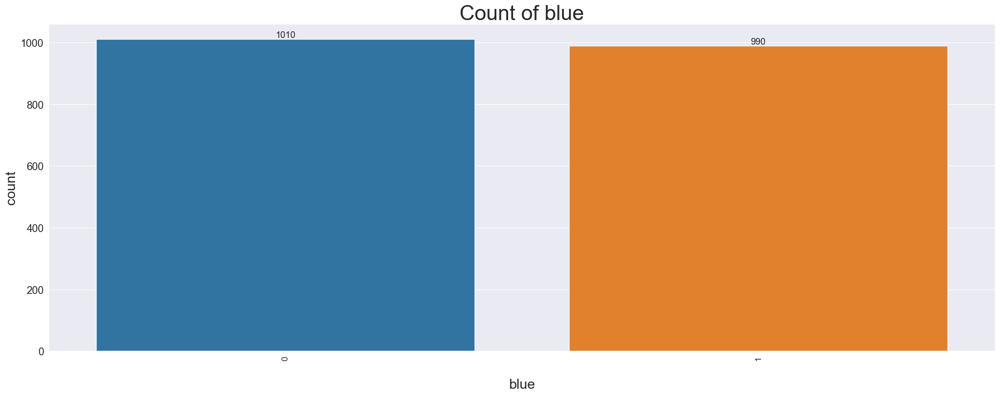

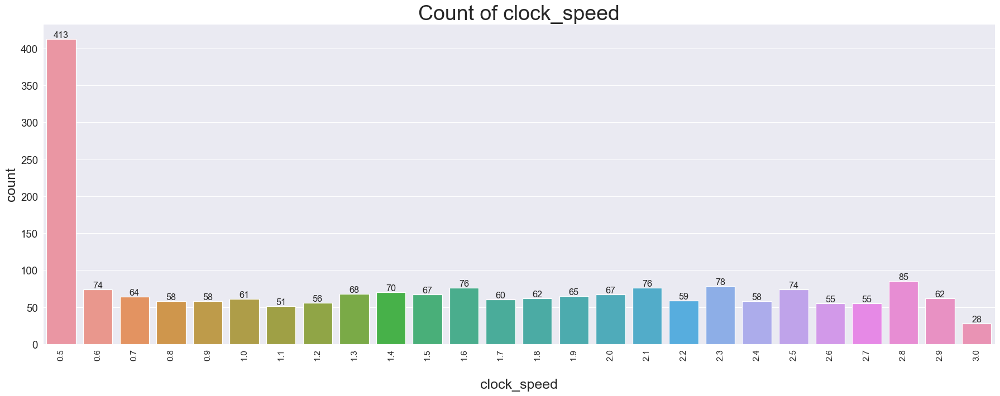

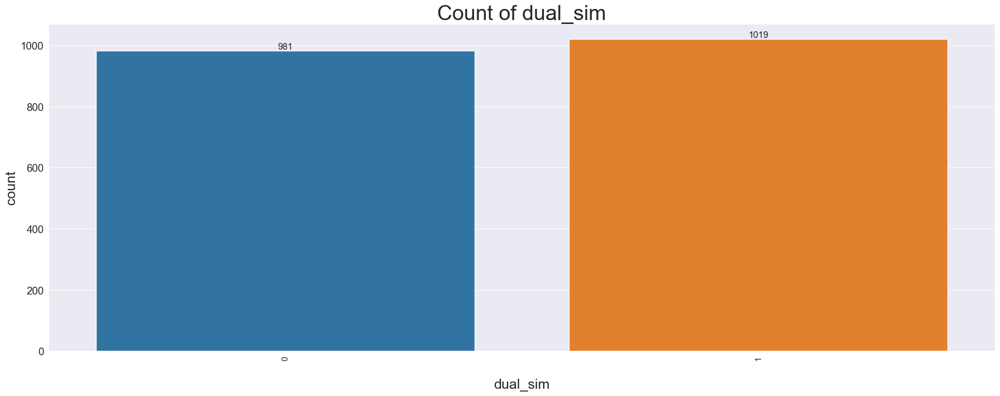

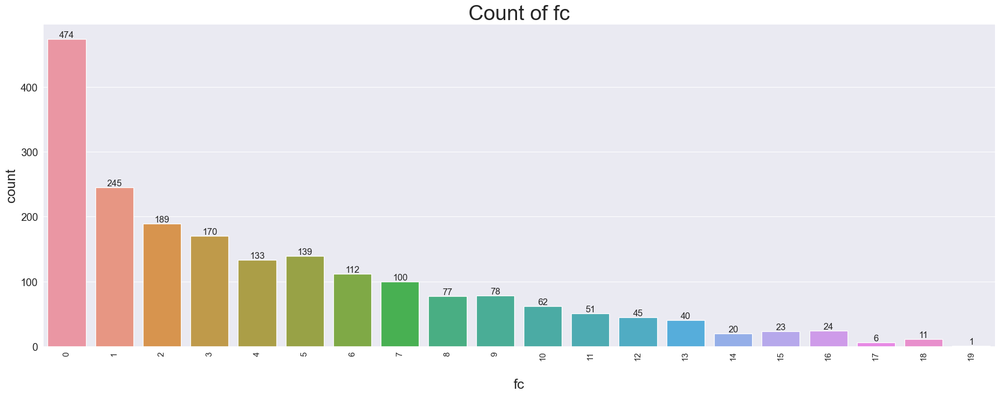

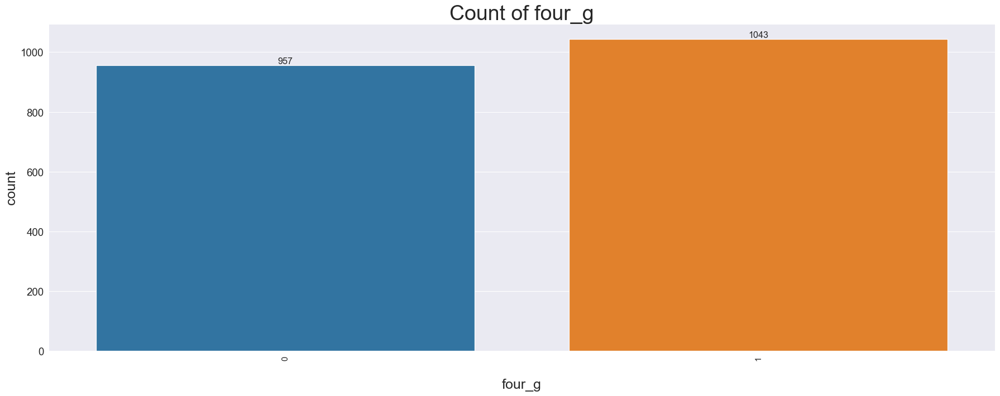

...

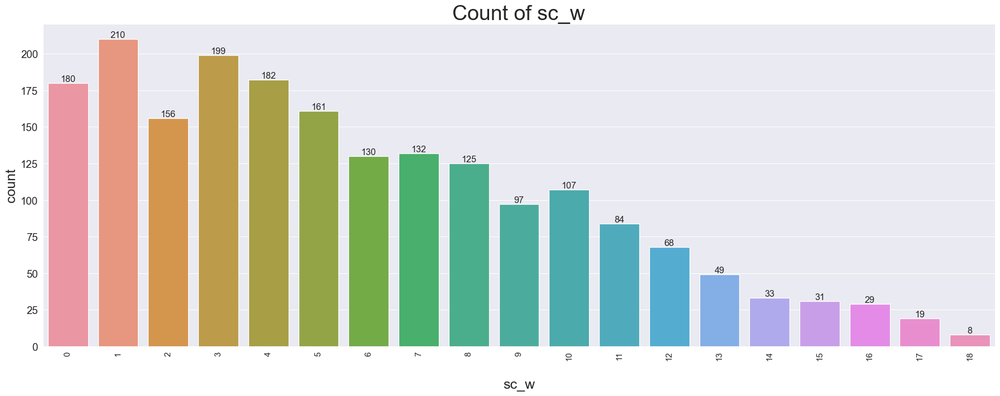

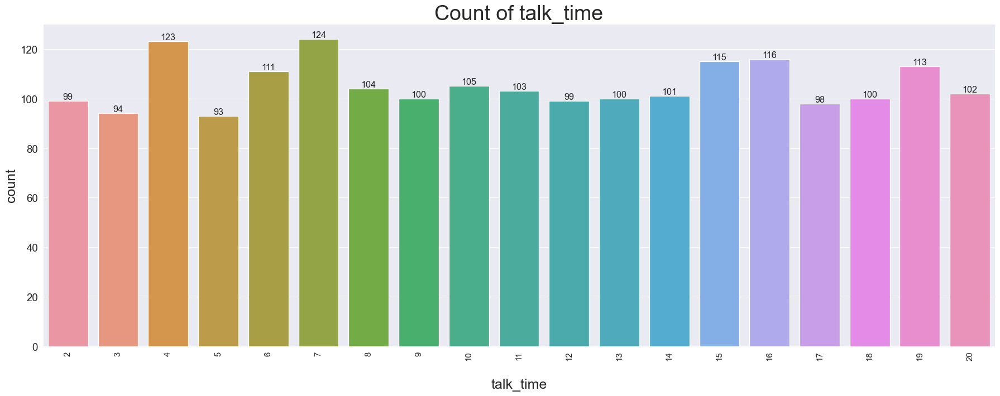

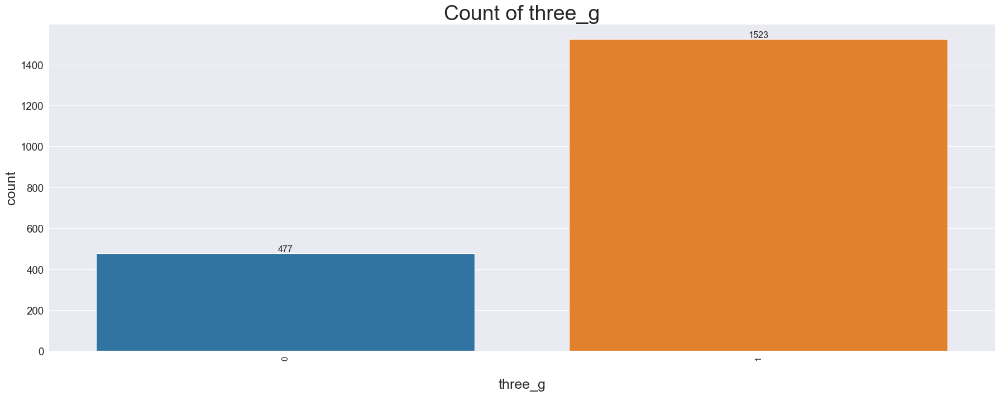

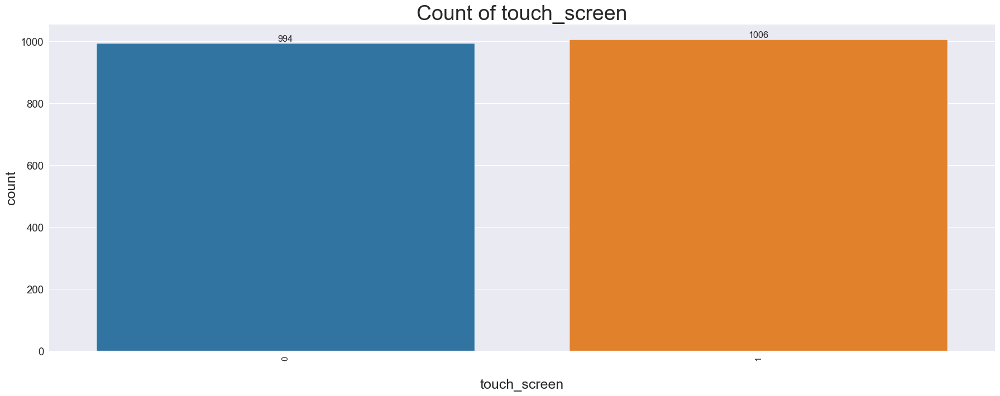

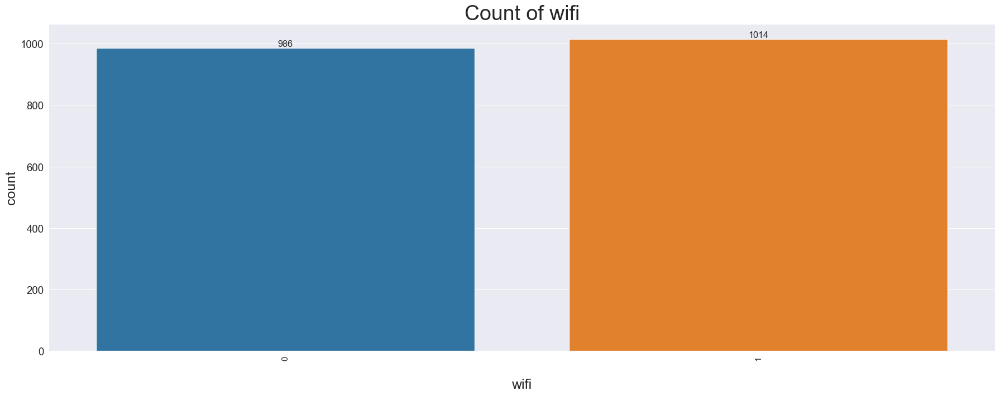

In [ ]:
#Drawing the count plots.

i = 0
j = len(train.columns)-1
while i<=j:
  if(train.columns[i] != "ram") and (train.columns[i] != "battery_power") and (train.columns[i] != "px_width") and (train.columns[i] != "px_height") and (train.columns[i] != "price_range"):
    count_plots(train, train.columns[i])
    plt.grid()
    i += 1
    plt.tight_layout()
    plt.show()
  else:
    i +=1

###Step 4.4: Checking whether the dataset is balanced.

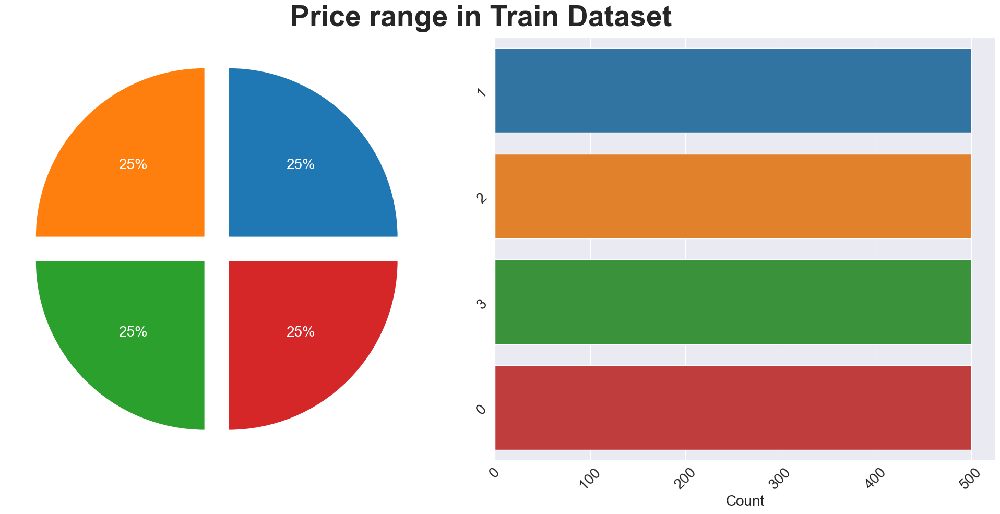

In [ ]:
fig, ax = plt.subplots(1, 2, figsize = (20, 10))
ax = ax.flatten()

ax[0].pie(
    train['price_range'].value_counts(),
    autopct = '%1.f%%',
    textprops = {'size' : 20, 'color' : 'white'},
    explode = [.1 for i in range(0, 4)],
    )

sns.countplot(data = train, y = 'price_range', ax = ax[1], order = train['price_range'].value_counts().index)
ax[1].yaxis.label.set_size(20)
plt.yticks(fontsize = 20,rotation=45)
ax[1].set_xlabel('Count', fontsize = 20)
ax[1].set_ylabel(None)
plt.xticks(fontsize = 20, rotation=45)

fig.suptitle('Price range in Train Dataset', fontsize = 40, fontweight = 'bold')
plt.tight_layout()


We see that our target is Balanced. So we can use Accuracy metric for evaluationg
We have a balanced target.

###Step 4.4: Distribution of features

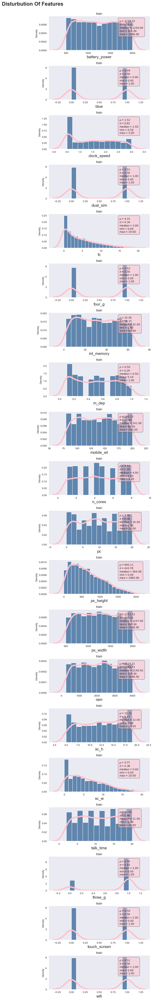

In [ ]:
sns.set_style('darkgrid')
color = 'royalblue'

plt.figure(figsize = (12,55))
i = 0
for index, col in enumerate(list(train_without_target.columns.values)):
    i += 1 ;
    plt.subplot(21,2, index + i)
    ax = sns.histplot(x = col, data = train_without_target, color = "#326598", stat = "density", common_norm=False)
    sns.kdeplot(x = col, data = train_without_target, color = "pink", linewidth = 5)
    plt.xlabel(col, size = 15)
    plt.title('train')
    # set text on axes
    textstr_train = '\n'.join((
    r'$\mu=%.2f$' %train_without_target[col].mean(),
    r'$\sigma=%.2f$' %train_without_target[col].std(),
    r'$\mathrm{median}=%0.2f$' %np.median(train_without_target[col]),
    r'$\mathrm{min}=%.2f$' %train_without_target[col].min(),
    r'$\mathrm{max}=%.2f$' %train_without_target[col].max()
    ))
    ax.text(0.7, 0.90, textstr_train, transform=ax.transAxes, fontsize=10, verticalalignment='top',
                     bbox=dict(boxstyle='round',facecolor='pink', edgecolor='black', pad=0.5, alpha = 0.5))


    plt.grid()

plt.suptitle("Disturbution Of Features", y = 1, x = 0, size = 20,
    fontweight = "bold")
plt.tight_layout()
plt.show()

In [ ]:
#Seperating the numerical and categorical features.
num_columns=['battery_power','clock_speed', 'fc', 'int_memory','m_dep','mobile_wt','pc','px_height','px_width','ram','sc_h','sc_w','talk_time']
cat_columns=['blue','dual_sim','four_g','n_cores', 'three_g','touch_screen','wifi']

###Step 4.5: EDA for categorical features.

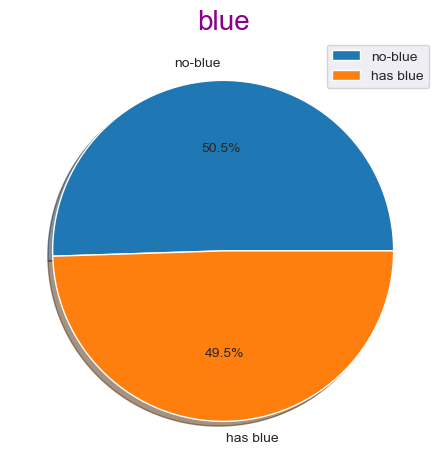

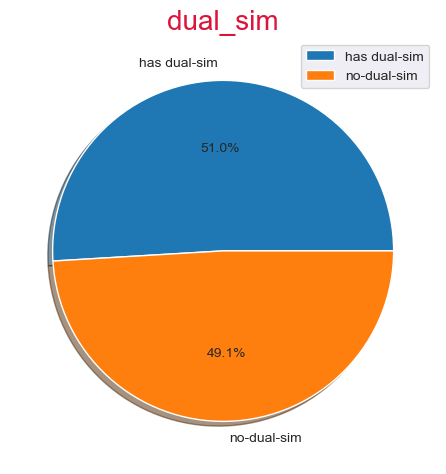

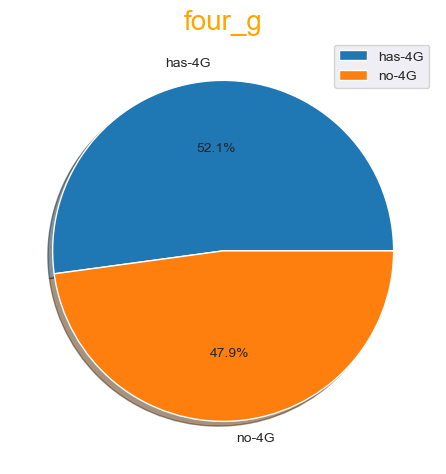

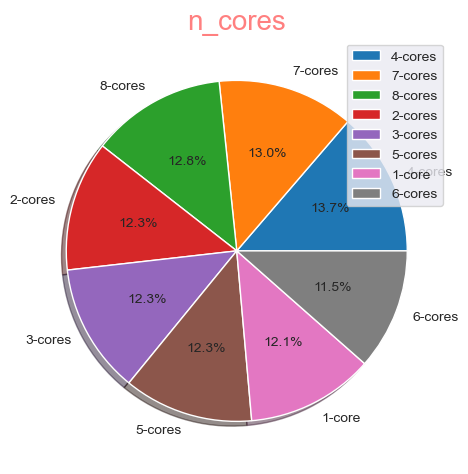

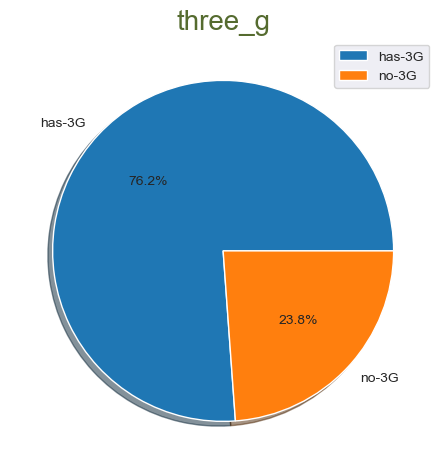

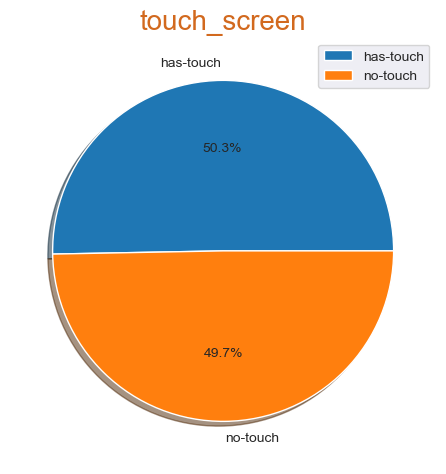

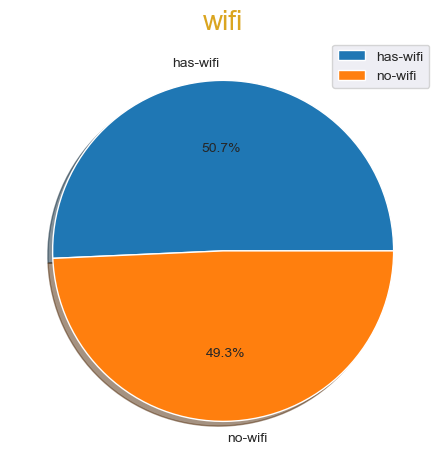

In [ ]:
colors_cat=['#8B008B','#DC143C','#FFA500','#ff8080','#556B2F','#D2691E','#DAA520']
new_train=train.replace(to_replace={'blue':[0,1],'dual_sim':[0,1],'four_g':[0,1],
                      'n_cores':[1,2,3,4,5,6,7,8],'three_g':[0,1],'touch_screen':[0,1],'wifi':[0,1]},
           value={'blue':['no-blue','has blue'],
                  'dual_sim':['no-dual-sim','has dual-sim'],
                 'four_g':['no-4G','has-4G'],
                 'n_cores':['1-core','2-cores','3-cores','4-cores','5-cores','6-cores','7-cores','8-cores'],
                 'three_g':['no-3G','has-3G'],
                 'touch_screen':['no-touch','has-touch'],
                 'wifi':['no-wifi','has-wifi']})
for i,c in enumerate(cat_columns):
    plt.figure(figsize =(5.5, 6.5))
    plt.pie(new_train[c].value_counts() ,labels=list(new_train[c].value_counts().index),shadow = True,autopct='%1.1f%%')
    plt.legend()
    plt.title(c,color=colors_cat[i],fontsize=20)


*  The number of phones that use Bluetooth is very close to the number of phone whom do not use it
*  Also, the number of phones with two SIM cards is very close to the number of single SIM phones
*  The number of phones with 4G is slightly more than the number of phones without 4G
*  The number of phones with different types of number of cores have an almost equal distribution
*  The number of touch screen and Wi-Fi have the same distribution as above
*  But The number of phones that use 3G is much more than the number of phones that do not use it

###Step 4.6: EDA for numerical features.

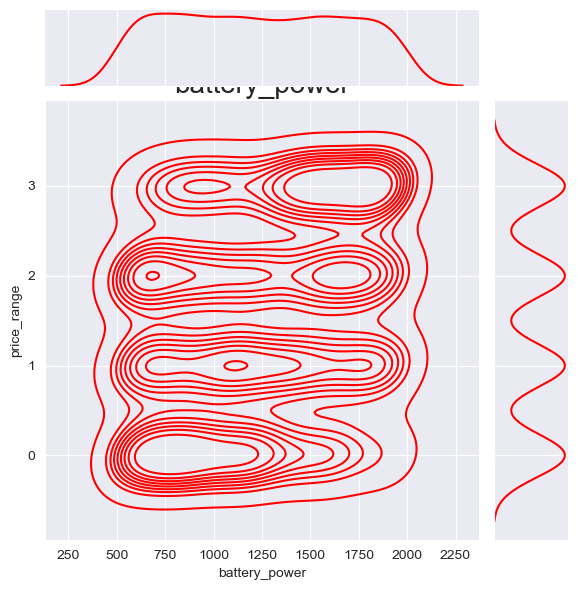

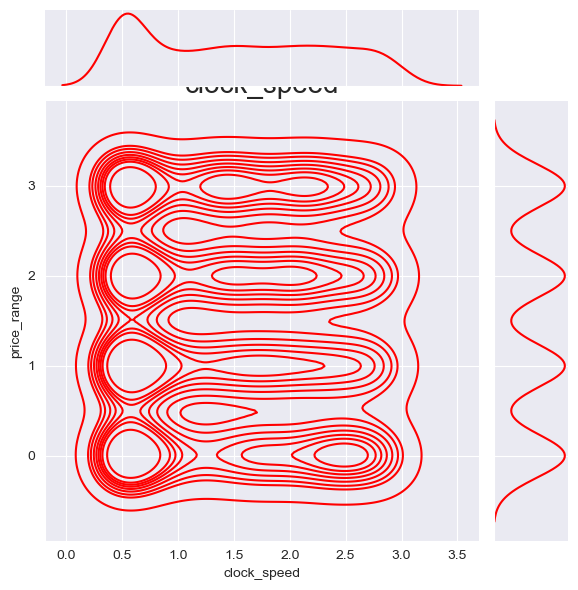

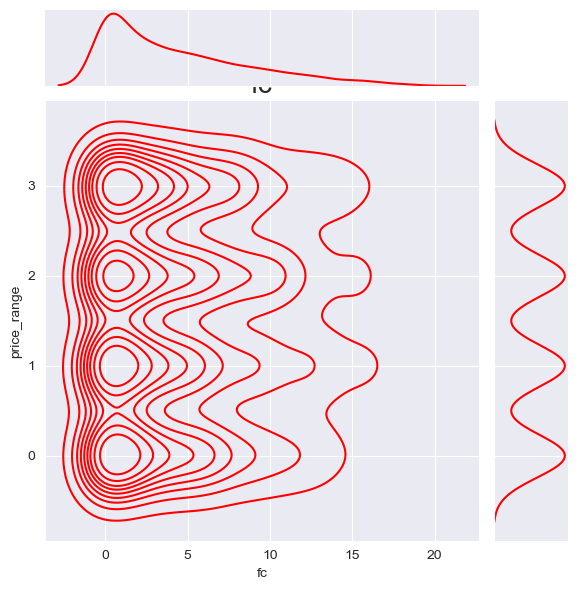

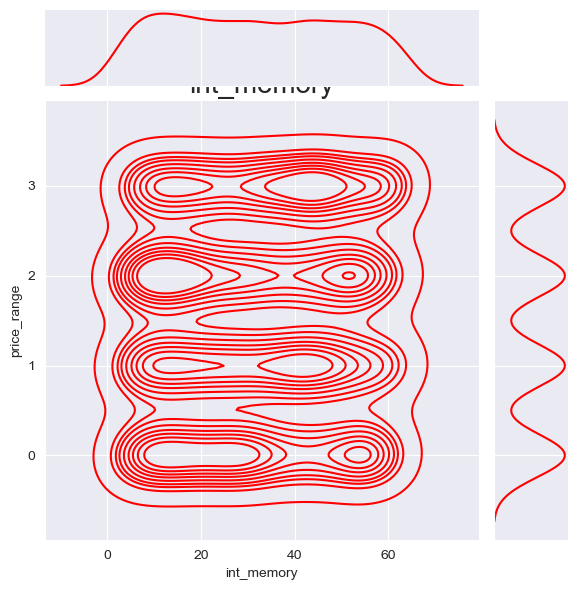

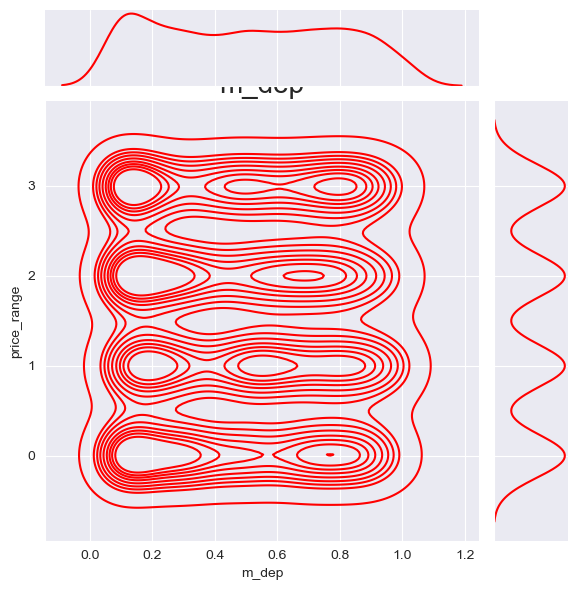

...

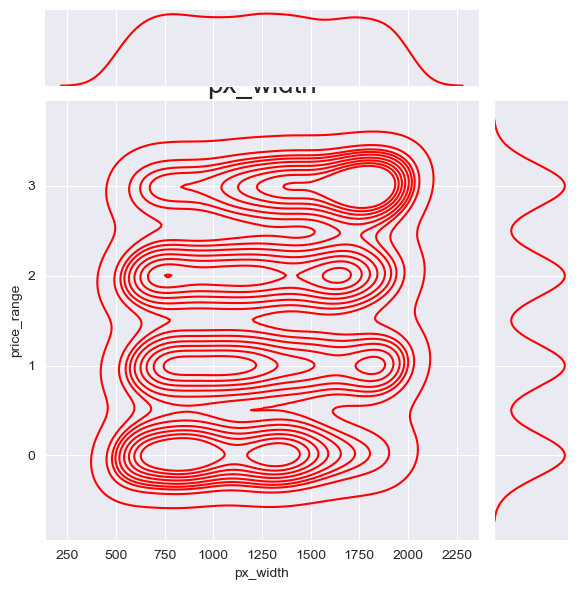

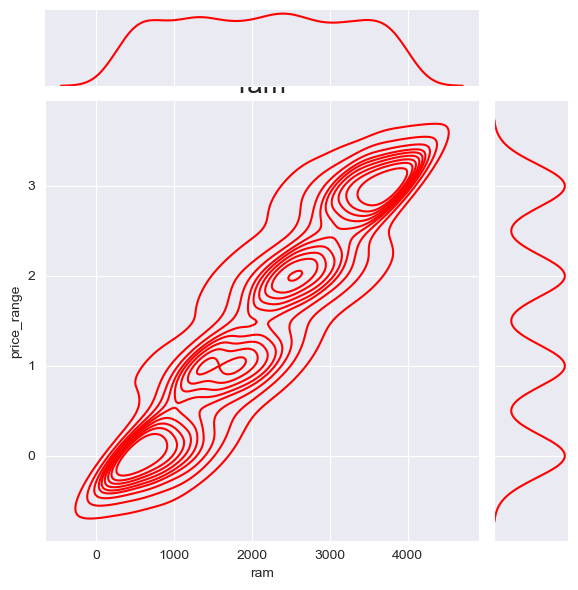

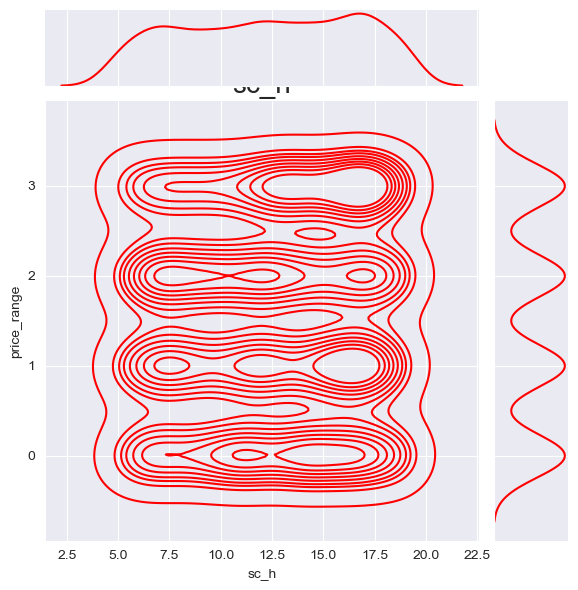

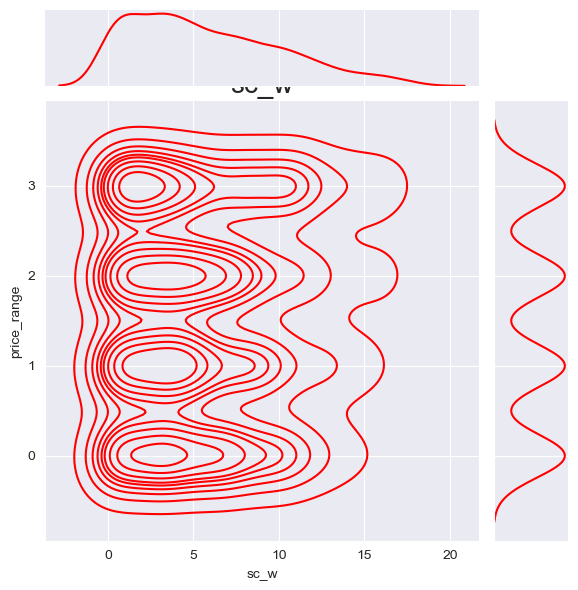

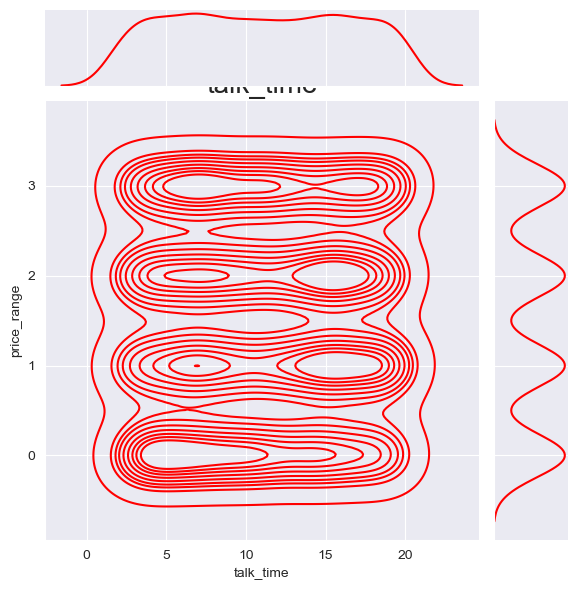

In [ ]:
for i,c in enumerate(num_columns):
    sns.jointplot(x=c ,y='price_range',data=train,kind='kde',palette = "dict",color='#FF0000')
    plt.xlabel(c)
    plt.ylabel('price_range')
    plt.title(c,fontsize=20)

*  battery_power: The high concentration of phones in the class zero range, below 1500 mAh is evident, And as for the more expensive phones, their battery power is above 1500 mAh, it was the same as we expected.

*  clock_speed: There is a concentration below 1.0 GHz for all groups, However, in all 4 categories, bipolars can also be seen.

*  fc: The same bipolars that we mentioned above are not visible in the case of the front camera

*  int_memory: For class 3 phones, which are also the most expensive, there is a lot of concentration for values above 35 GB for internal memory. On the other hand, cheaper phones usually have lower values for internal memory

*  m_dep: Usually, cheaper phones have less depth and more expensive phones have higher depth

*  mobile_wt: More expensive phones weigh less, but phones in class 2 weigh more. But class 2 have big concentration in higher than 120gr.

*  pc: Class 1 phones have a primary camera less than 15 mega pixels, but class zero phones usually have a higher primary camera. (According to this data set, we obtained this information, it may not be the case in reality)

*  px_height: In all groups the number of phones that have less than 600 pixel in height are more.

*  px_width: In expensive phones, the number of pixels in the width of the phone is higher than 1000 pixels, but in class 1 and 2 phones, this amount is less than 1000 pixels.

*  ram: In general, the more expensive phone has higher ram.

*  sc_h: The height of most class 3 phones is higher than 12 cm, but this feature is not very evident in other classes

*  sc_w: It can be said that unlike the above feature, the width of more expensive phones is less

###Step 4.7: Creating the boxplots.

A box plot is a statistical representation of the distribution of a variable through its quartiles. The ends of the box represent the lower and upper quartiles, while the median (second quartile) is marked by a line inside the box.

In [ ]:
def create_boxplot(data,x,y):
    fig = px.box(data, x=x, y=y, color = "price_range", title = f"Box Plots\n{x} vs {y}")
    fig.show()

In [ ]:
for feature in num_columns:
    create_boxplot(data=train,y=feature,x="price_range")

##Step 5: Training the models

In [ ]:
test=pd.read_csv("/Users/DELL/Downloads/test.csv")
test.shape

(1000, 21)

In [ ]:
test.head()

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1,1043,1,1.8,1,14,0,5,0.1,193,3,16,226,1412,3476,12,7,2,0,1,0
1,2,841,1,0.5,1,4,1,61,0.8,191,5,12,746,857,3895,6,0,7,1,0,0
2,3,1807,1,2.8,0,1,0,27,0.9,186,3,4,1270,1366,2396,17,10,10,0,1,1
3,4,1546,0,0.5,1,18,1,25,0.5,96,8,20,295,1752,3893,10,0,7,1,1,0
4,5,1434,0,1.4,0,11,1,49,0.5,108,6,18,749,810,1773,15,8,7,1,0,1


The column 'id' does not contribute towards price prediction, thus we drop that column.

In [ ]:
X = train.drop(columns=['price_range'])
y = train.price_range
X_train, X_valid, y_train, y_valid = train_test_split(X, y, train_size=0.8, test_size=0.2)

In [ ]:
#function for metrics calculation, after the model is designed.
def metrics_calculator(clf, X_valid, y_valid, model_name):
    y_pred = clf.predict(X_valid)
    result = pd.DataFrame(data=[accuracy_score(y_valid, y_pred),
                                precision_score(y_valid, y_pred, average='macro'),
                                recall_score(y_valid, y_pred, average='macro'),
                                f1_score(y_valid, y_pred, average='macro')],
                          index=['Accuracy','Macro Precision','Macro Recall','Macro F1-score'],
                          columns = [model_name])

    result = (result * 100).round(2).astype(str) + '%'
    return result

In [ ]:
#function for model evaluation.
def model_evaluation(clf, X_train, X_valid, y_train, y_valid, model_name):
    y_pred_train = clf.predict(X_train)
    print("\n\t  Classification report for training set")
    print("-"*55)
    print(classification_report(y_train, y_pred_train))
    y_pred_valid = clf.predict(X_valid)
    print("\n\t   Classification report for valid set")
    print("-"*55)
    print(classification_report(y_valid, y_pred_valid))
    print('\n')
    fig, (ax1, ax2) = plt.subplots(1, 2, dpi=90, figsize=(12, 5))

    result = metrics_calculator(clf, X_valid, y_valid, model_name)
    table = ax1.table(cellText=result.values, colLabels=result.columns, rowLabels=result.index, loc='center')
    table.scale(0.6, 4.2)
    table.set_fontsize(12)
    ax1.axis('tight')
    # Hide the axes
    ax1.axis('off')
    # set the title
    ax1.set_title('{} Performance Summary on Test Data'.format(model_name), fontsize=18)
    for key, cell in table.get_celld().items():
        if key[0] == 0:
            cell.set_color('#FFB6C1')

    ConfusionMatrixDisplay.from_estimator(clf, X_valid, y_valid, colorbar=False, ax=ax2)
    ax2.set_title('Confusion Matrix for Test Data')
    ax2.grid(False)
    plt.tight_layout()
    plt.show()


###Step 5.1: Logistic Regression.

Logistic regression is a Machine Learning classification algorithm that is used to predict the probability of certain classes based on some dependent variables. In short, the logistic regression model computes a sum of the input features (in most cases, there is a bias term), and calculates the logistic of the result.

C:\Users\DELL\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression




	  Classification report for training set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.83      0.79      0.81       401
           1       0.56      0.56      0.56       403
           2       0.50      0.45      0.48       394
           3       0.67      0.77      0.72       402

    accuracy                           0.64      1600
   macro avg       0.64      0.64      0.64      1600
weighted avg       0.64      0.64      0.64      1600


	   Classification report for valid set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.79      0.78      0.78        99
           1       0.51      0.56      0.53        97
           2       0.53      0.43      0.48       106
           3       0.65      0.73      0.69        98

    accuracy                           0.62       400
   macro avg       0.62      0.63      0.62

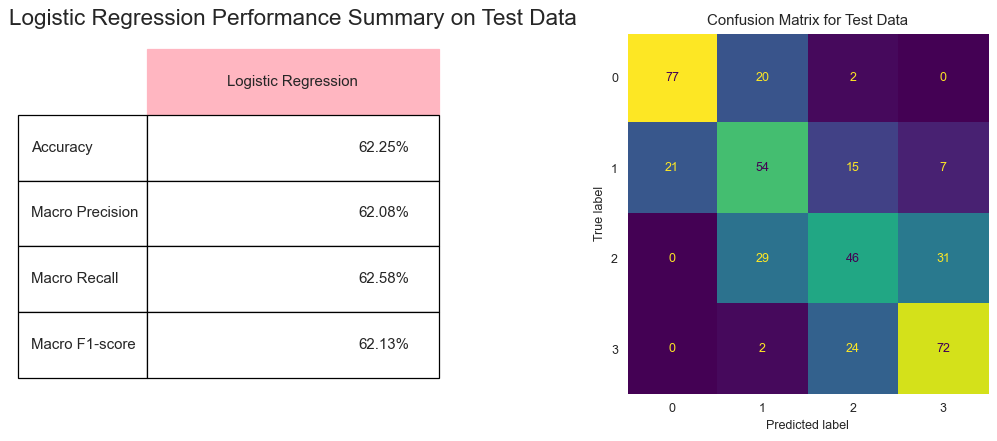

In [ ]:
lr=LogisticRegression()
lr.fit(X_train,y_train)
prediction_log = lr.predict(X_valid)
as_log = accuracy_score(y_valid,prediction_log)
model_evaluation(lr, X_train, X_valid, y_train, y_valid, 'Logistic Regression')

Accuracy of Logistic Regression model is: 65.0%

###Step 5.2: Decision Tree Classifier

A decision tree is a type of supervised machine learning used to categorize or make predictions based on how a previous set of questions were answered. The model is a form of supervised learning, meaning that the model is trained and tested on a set of data that contains the desired categorization.


	  Classification report for training set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       401
           1       1.00      1.00      1.00       403
           2       1.00      1.00      1.00       394
           3       1.00      1.00      1.00       402

    accuracy                           1.00      1600
   macro avg       1.00      1.00      1.00      1600
weighted avg       1.00      1.00      1.00      1600


	   Classification report for valid set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.87      0.89        99
           1       0.76      0.87      0.81        97
           2       0.84      0.75      0.80       106
           3       0.88      0.90      0.89        98

    accuracy                           0.84       400
   macro avg       0.85      0.85      0.85

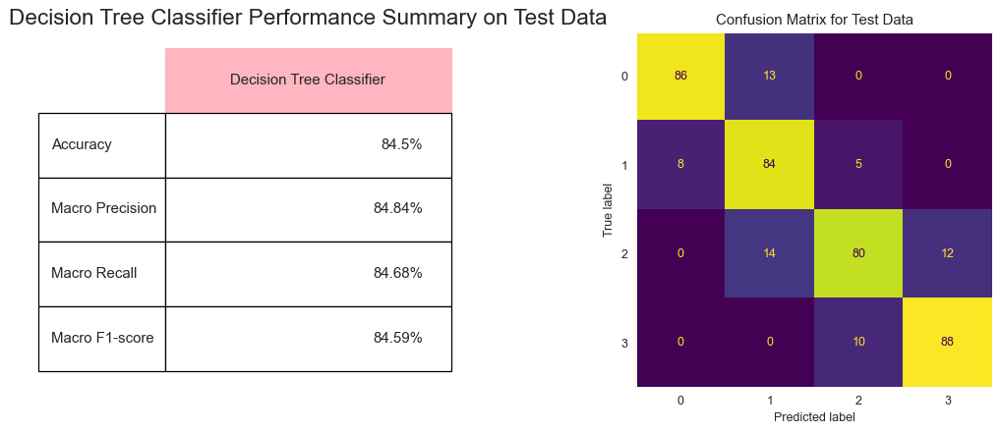

In [ ]:
decision_tree = DecisionTreeClassifier(random_state=2)
decision_tree.fit(X_train,y_train)
prediction_tree = decision_tree.predict(X_valid)
as_tree = accuracy_score(y_valid,prediction_tree)
model_evaluation(decision_tree, X_train, X_valid, y_train, y_valid, 'Decision Tree Classifier')

Accuracy of Decision Tree model is: 86.0%

###Step 5.3: Random Forest Classifier.

Random Forest is a classifier that contains a number of decision trees on various subsets of the given dataset and takes the average to improve the predictive accuracy of that dataset.


	  Classification report for training set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       401
           1       1.00      1.00      1.00       403
           2       1.00      1.00      1.00       394
           3       1.00      1.00      1.00       402

    accuracy                           1.00      1600
   macro avg       1.00      1.00      1.00      1600
weighted avg       1.00      1.00      1.00      1600


	   Classification report for valid set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.92      0.94        99
           1       0.82      0.86      0.84        97
           2       0.86      0.83      0.85       106
           3       0.92      0.96      0.94        98

    accuracy                           0.89       400
   macro avg       0.89      0.89      0.89

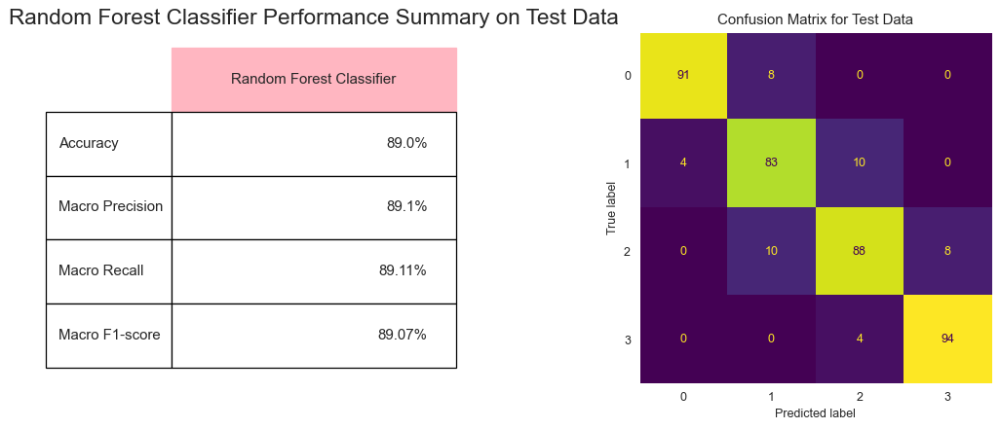

In [ ]:
forest_model = RandomForestClassifier(n_estimators=200, random_state=2)
forest_model.fit(X_train, y_train)
predictions_forest = forest_model.predict(X_valid)
as_forest = accuracy_score(y_valid, predictions_forest)
model_evaluation(forest_model, X_train, X_valid, y_train, y_valid, 'Random Forest Classifier')

Accuracy of Random Forest model is: 88.75%

###Step 5.4: XGB Classifier.

XGBoost classifier is a Machine learning algorithm that is applied for structured and tabular data. XGBoost is an implementation of gradient boosted decision trees designed for speed and performance.


	  Classification report for training set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       401
           1       1.00      1.00      1.00       403
           2       1.00      1.00      1.00       394
           3       1.00      1.00      1.00       402

    accuracy                           1.00      1600
   macro avg       1.00      1.00      1.00      1600
weighted avg       1.00      1.00      1.00      1600


	   Classification report for valid set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.94      0.93      0.93        99
           1       0.86      0.85      0.85        97
           2       0.87      0.89      0.88       106
           3       0.94      0.95      0.94        98

    accuracy                           0.90       400
   macro avg       0.90      0.90      0.90

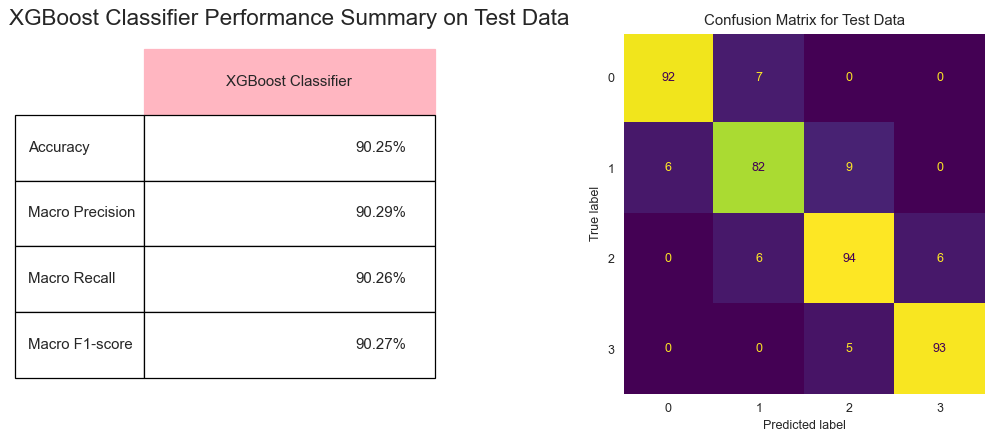

In [ ]:
model_xgboost = XGBClassifier(n_estimators=200, random_state=2, learning_rate=0.15)
model_xgboost.fit(X_train, y_train)
predictions_xgboost = model_xgboost.predict(X_valid)
as_xgboost = accuracy_score(y_valid, predictions_xgboost)
model_evaluation(model_xgboost, X_train, X_valid, y_train, y_valid, 'XGBoost Classifier')

Accuracy of XGBooster model is: 93.0%

###Step 5.5: Naive Bayes Classifier.

Naïve Bayes algorithm is a supervised learning algorithm, which is based on Bayes theorem and used for solving classification problems. It is a probabilistic classifier, which means it predicts on the basis of the probability of an object.


	  Classification report for training set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.91      0.91       401
           1       0.73      0.74      0.74       403
           2       0.72      0.73      0.72       394
           3       0.90      0.89      0.90       402

    accuracy                           0.82      1600
   macro avg       0.82      0.82      0.82      1600
weighted avg       0.82      0.82      0.82      1600


	   Classification report for valid set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.85      0.88        99
           1       0.63      0.68      0.66        97
           2       0.74      0.74      0.74       106
           3       0.96      0.96      0.96        98

    accuracy                           0.81       400
   macro avg       0.81      0.81      0.81

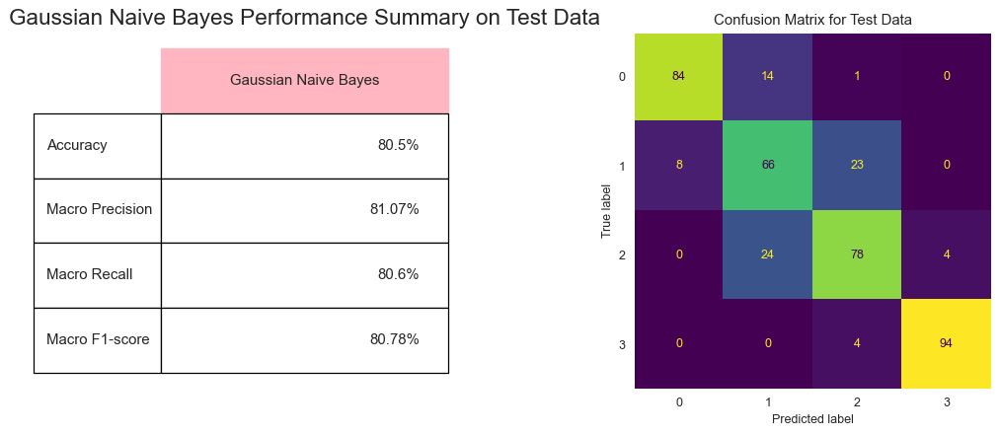


	  Classification report for training set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.29      0.34      0.31       401
           1       0.25      0.16      0.20       403
           2       0.27      0.19      0.22       394
           3       0.29      0.42      0.34       402

    accuracy                           0.28      1600
   macro avg       0.27      0.28      0.27      1600
weighted avg       0.27      0.28      0.27      1600


	   Classification report for valid set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.21      0.27      0.24        99
           1       0.18      0.11      0.14        97
           2       0.35      0.18      0.24       106
           3       0.23      0.38      0.29        98

    accuracy                           0.23       400
   macro avg       0.25      0.24      0.23

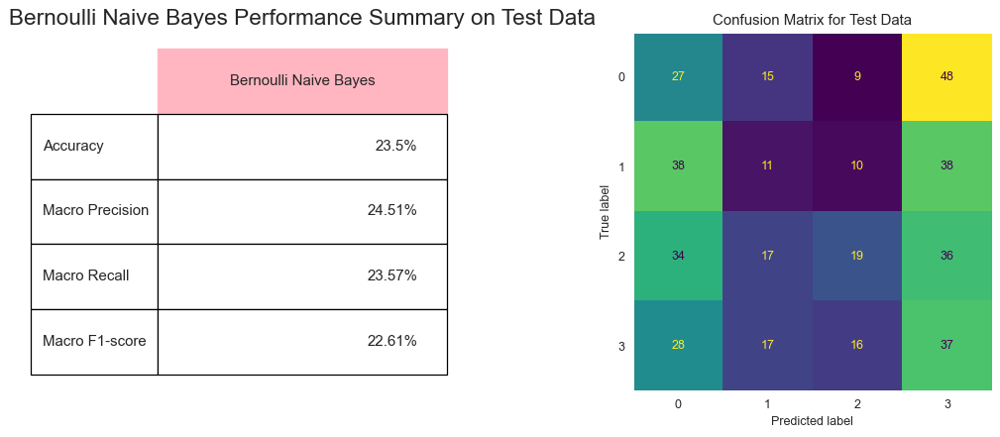

In [ ]:
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import BernoulliNB

nb=GaussianNB()
nb1=BernoulliNB()
nb.fit(X_train,y_train)
nb1.fit(X_train,y_train)

predictions_nb = nb.predict(X_valid)
as_nb = accuracy_score(y_valid, predictions_nb)
model_evaluation(nb, X_train, X_valid, y_train, y_valid, 'Gaussian Naive Bayes')

predictions_nb1 = nb1.predict(X_valid)
as_nb1 = accuracy_score(y_valid, predictions_nb1)
model_evaluation(nb1, X_train, X_valid, y_train, y_valid, 'Bernoulli Naive Bayes')

Accuracy of Naive Bayes (Gaussian) model is: 78.5%
Accuracy of Naive Bayes (Bernoulli) model is: 24.0%

###Step 5.6: KNN Classifier.

K-Nearest Neighbour is one of the simplest Machine Learning algorithms based on Supervised Learning technique.
K-NN algorithm assumes the similarity between the new case/data and available cases and put the new case into the category that is most similar to the available categories.
K-NN algorithm stores all the available data and classifies a new data point based on the similarity. This means when new data appears then it can be easily classified into a well suite category by using K- NN algorithm.


	  Classification report for training set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.98      0.99      0.98       401
           1       0.94      0.96      0.95       403
           2       0.93      0.92      0.92       394
           3       0.97      0.95      0.96       402

    accuracy                           0.95      1600
   macro avg       0.95      0.95      0.95      1600
weighted avg       0.95      0.95      0.95      1600


	   Classification report for valid set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.93      0.95      0.94        99
           1       0.87      0.84      0.85        97
           2       0.89      0.90      0.89       106
           3       0.96      0.97      0.96        98

    accuracy                           0.91       400
   macro avg       0.91      0.91      0.91

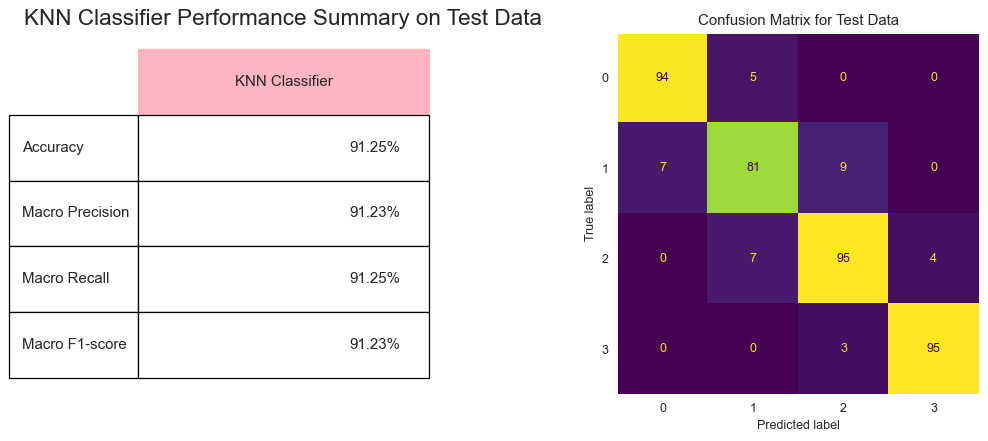

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn=KNeighborsClassifier(n_neighbors=15)
knn.fit(X_train,y_train)
predictions_knn = knn.predict(X_valid)
as_knn = accuracy_score(y_valid, predictions_knn)
model_evaluation(knn, X_train, X_valid, y_train, y_valid, 'KNN Classifier')

Accuracy of KNN model is: 94.25%

###Step 5.7: SVM.

Support Vector Machine or SVM is one of the most popular Supervised Learning algorithms, which is used for Classification as well as Regression problems. However, primarily, it is used for Classification problems in Machine Learning.
The goal of the SVM algorithm is to create the best line or decision boundary that can segregate n-dimensional space into classes so that we can easily put the new data point in the correct category in the future.


	  Classification report for training set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.97      0.99      0.98       401
           1       0.94      0.96      0.95       403
           2       0.94      0.91      0.92       394
           3       0.96      0.96      0.96       402

    accuracy                           0.95      1600
   macro avg       0.95      0.95      0.95      1600
weighted avg       0.95      0.95      0.95      1600


	   Classification report for valid set
-------------------------------------------------------
              precision    recall  f1-score   support

           0       0.96      0.95      0.95        99
           1       0.88      0.92      0.90        97
           2       0.96      0.91      0.93       106
           3       0.97      1.00      0.98        98

    accuracy                           0.94       400
   macro avg       0.94      0.94      0.94

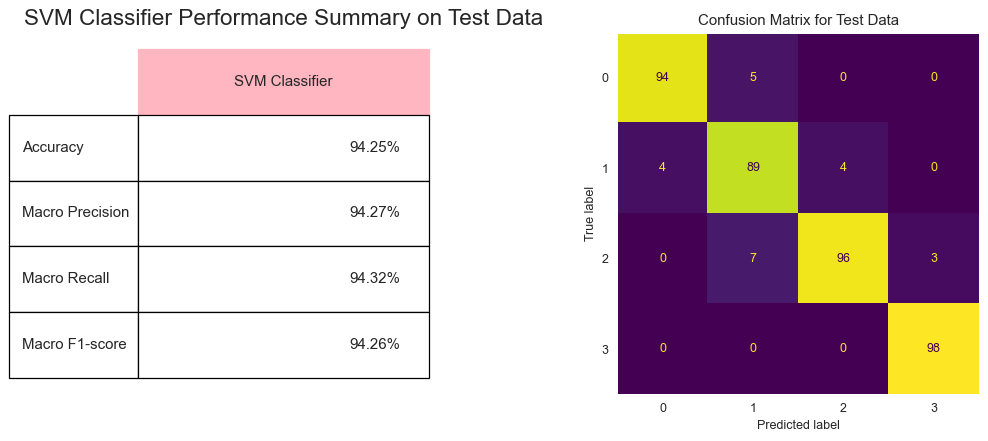

In [ ]:
from sklearn.svm import SVC
svm=SVC(random_state=1)
svm.fit(X_train,y_train)
predictions_svm = svm.predict(X_valid)
as_svm = accuracy_score(y_valid, predictions_svm)
model_evaluation(svm, X_train, X_valid, y_train, y_valid, 'SVM Classifier')

Accuracy of SVM model is: 95.25%

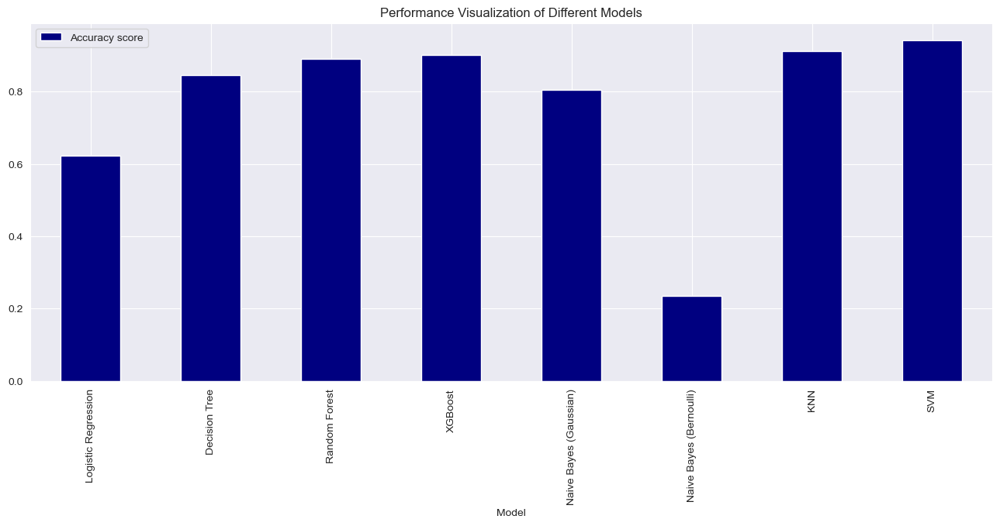

In [ ]:
models = ["Logistic Regression","Decision Tree","Random Forest","XGBoost", "Naive Bayes (Gaussian)", "Naive Bayes (Bernoulli)", "KNN", "SVM"]
accuracy_scores = [as_log,as_tree,as_forest,as_xgboost,as_nb,as_nb1,as_knn,as_svm]
df = pd.DataFrame({"Model":models,
                   "Accuracy score":accuracy_scores})
df.plot(x="Model",y="Accuracy score", figsize=(16,6),kind="bar",
        title="Performance Visualization of Different Models",colormap="jet")
plt.show()

Thus, from the above graph it is clear that the SVM model predicts the smart mobile phone price range with the highest accuracy (95.25%) among other trained models.

We can thus try to create models of each of the ML algorithms used, using joblib library from sklearn.

In [ ]:
#importing joblib for model saving.
import joblib

In [ ]:
#making the Logistic Regression model.
joblib.dump(lr, 'logistic_regression')

['logistic_regression']

In [ ]:
#making the Decision Tree model.
joblib.dump(decision_tree, 'decision_tree')

['decision_tree']

In [ ]:
#making a Random Forest model.
joblib.dump(forest_model, 'random_forest')

['random_forest']

In [ ]:
#making an XGBoost model.
joblib.dump(model_xgboost, 'XGBoost')

['XGBoost']

In [ ]:
#making a Gaussian Naive Bayes model.
joblib.dump(nb, 'gaussian_nb')

['gaussian_nb']

In [ ]:
#making a Bernoulli Naive Bayes model
joblib.dump(nb1, 'bernoulli_nb')

['bernoulli_nb']

In [ ]:
#making a KNN model.
joblib.dump(knn, 'KNN')

['KNN']

In [ ]:
#making a SVM model
joblib.dump(svm, 'SVM')

['SVM']

In [ ]:
train

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,794,1,0.5,1,0,1,2,0.8,106,6,14,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,3,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,3,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,5,336,670,869,18,10,19,1,1,1,0


In [ ]:
test

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1,1043,1,1.8,1,14,0,5,0.1,193,3,16,226,1412,3476,12,7,2,0,1,0
1,2,841,1,0.5,1,4,1,61,0.8,191,5,12,746,857,3895,6,0,7,1,0,0
2,3,1807,1,2.8,0,1,0,27,0.9,186,3,4,1270,1366,2396,17,10,10,0,1,1
3,4,1546,0,0.5,1,18,1,25,0.5,96,8,20,295,1752,3893,10,0,7,1,1,0
4,5,1434,0,1.4,0,11,1,49,0.5,108,6,18,749,810,1773,15,8,7,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,1700,1,1.9,0,0,1,54,0.5,170,7,17,644,913,2121,14,8,15,1,1,0
996,997,609,0,1.8,1,0,0,13,0.9,186,4,2,1152,1632,1933,8,1,19,0,1,1
997,998,1185,0,1.4,0,1,1,8,0.5,80,1,12,477,825,1223,5,0,14,1,0,0
998,999,1533,1,0.5,1,0,0,50,0.4,171,2,12,38,832,2509,15,11,6,0,1,0


##Step 6: Testing phase.

SVM is found to have the maximum accuracy out of all, so we try to predict the price range for the test dataset using the pre-trained SVM model.

In [ ]:
test_result=test.drop('id',axis=1)
predicted_price=svm.predict(test_result)
test_result['price_range']=predicted_price
test_result

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,1043,1,1.8,1,14,0,5,0.1,193,3,16,226,1412,3476,12,7,2,0,1,0,3
1,841,1,0.5,1,4,1,61,0.8,191,5,12,746,857,3895,6,0,7,1,0,0,3
2,1807,1,2.8,0,1,0,27,0.9,186,3,4,1270,1366,2396,17,10,10,0,1,1,3
3,1546,0,0.5,1,18,1,25,0.5,96,8,20,295,1752,3893,10,0,7,1,1,0,3
4,1434,0,1.4,0,11,1,49,0.5,108,6,18,749,810,1773,15,8,7,1,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,1700,1,1.9,0,0,1,54,0.5,170,7,17,644,913,2121,14,8,15,1,1,0,2
996,609,0,1.8,1,0,0,13,0.9,186,4,2,1152,1632,1933,8,1,19,0,1,1,1
997,1185,0,1.4,0,1,1,8,0.5,80,1,12,477,825,1223,5,0,14,1,0,0,0
998,1533,1,0.5,1,0,0,50,0.4,171,2,12,38,832,2509,15,11,6,0,1,0,2
